# CycleGAN Model 4: Female Portraits with LAMBDA = 20

The LAMBDA value of CycleGAN model was increased from 10 to 20 while using the same image dataset as CycleGAN Model 3. Increasing the value of LAMBDA would  give higher importance to cyclic consistency loss and identity loss with respect to adversarial loss. This would theoretically guide the model to prioritize the position of the facial features and reduce distortion. We will explore whether this would improve the content retention on the generated images

**Note**: This notebook was originally run on Google Colab and was reading files from Google Drive, but has been amended to reconcile with the local drive data structure required for github upload. Run cells has been copied from Google Colab such as training cell and pasted into this notebook as proof that the model was trained and showing all the expected output and generated images. This notebook may show Notebook Validation Error when opened locally.

In [1]:
#import the libraries
import tensorflow as tf
from keras.initializers import RandomNormal
from tensorflow.keras.layers import Input, Reshape, Dropout, Dense 
from tensorflow.keras.layers import Flatten, BatchNormalization
from tensorflow.keras.layers import Activation, ZeroPadding2D
from tensorflow.keras.layers import LeakyReLU, ReLU
from tensorflow.keras.layers import UpSampling2D, Conv2D, Conv2DTranspose
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Concatenate, Rescaling
from tensorflow.keras.optimizers import Adam
import numpy as np
import os 
import time
import matplotlib.pyplot as plt
import pathlib
!pip install visualkeras
import visualkeras
!pip3 install tensorflow-addons
from tensorflow_addons.layers import InstanceNormalization
AUTOTUNE = tf.data.AUTOTUNE

     |████████████████████████████████| 795 kB 7.9 MB/s 
     |████████████████████████████████| 1.1 MB 7.9 MB/s 


## Increase LAMBDA from 10 to 20 

In [3]:
# size of input image
input_img_size = (256, 256, 3)
img_rows, img_cols, channels = 256, 256, 3

# weights initializer for the layers.
weight_initializer = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

# define configuration
buffer_size = 256
batch_size = 1
data_path = '../model_and_gen_img/CycleGAN_4/'
epochs = 200

# hyperparameters
LAMBDA = 20 #increased from 10 to 20
LAMBDA_IDENT = 0.5

# set Adam optimizer 
gen_g_optimizer = gen_f_optimizer = Adam(lr=0.0002, beta_1=0.5)
dis_x_optimizer = dis_y_optimizer = Adam(lr=0.0002, beta_1=0.5)

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/optimizer_v2.py:356: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


We will now pre-process the image data

In [4]:
def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1] for 'tanh' activation
    return (img / 127.5) - 1.0

In [5]:
def decode_img(img):
  # Convert the compressed string to a 3D uint8 tensor
  img = tf.io.decode_jpeg(img, channels=3)
  # Resize the image to the desired size
  return tf.image.resize(img, [img_rows, img_cols])

In [6]:
def process_path(file_path):
  # Load the raw data from the file as a string
  img = tf.io.read_file(file_path)
  img = decode_img(img)
  return img

In [7]:
def preprocess_train_image(img):
    # Random flip
    img = tf.image.random_flip_left_right(img)
    # Resize to the 256 x 256 first
    img = tf.image.resize(img, [input_img_size[0], input_img_size[1]])
    # Normalize the pixel values in the range [-1, 1]
    img = normalize_img(img)
    return img

The number of training images is limited to 1216 even though more than 3000 images were available as CycleGAN is computationally very expensive

In [8]:
#Load the Anime train images
data_dir_anime_train = '../data/anime_female_portraits_3400/*'
anime_dir_train = pathlib.Path(data_dir_anime_train)
anime_ds_train = tf.data.Dataset.list_files(str(anime_dir_train), shuffle=True)
anime_ds_train = anime_ds_train.map(process_path, num_parallel_calls=AUTOTUNE)
anime_ds_train = anime_ds_train.prefetch(buffer_size=AUTOTUNE)
anime_ds_train = anime_ds_train.take(1216)

In [9]:
#Load the Real Life train images
data_dir_real_train = '../data/real_female_portraits_3318/*'
real_dir_train = pathlib.Path(data_dir_real_train)
real_ds_train = tf.data.Dataset.list_files(str(real_dir_train), shuffle=False)
real_ds_train = real_ds_train.map(process_path, num_parallel_calls=AUTOTUNE)
real_ds_train = real_ds_train.prefetch(buffer_size=AUTOTUNE)
real_ds_train = real_ds_train.take(1216)

In [10]:
anime_ds_train = anime_ds_train.cache().map(
    preprocess_train_image, num_parallel_calls=AUTOTUNE).shuffle(
    buffer_size).batch(batch_size)

real_ds_train = real_ds_train.cache().map(
    preprocess_train_image, num_parallel_calls=AUTOTUNE).shuffle(
    buffer_size).batch(batch_size)

## Sample Images

Let's visualize some samples

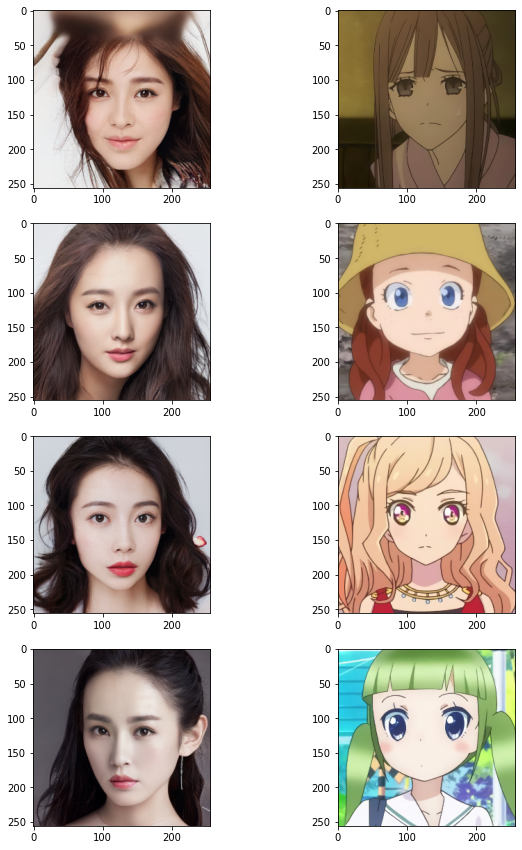

In [11]:
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, samples in enumerate(zip(real_ds_train.take(4), anime_ds_train.take(4))):
    real = (((samples[0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    anime = (((samples[1][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    ax[i, 0].imshow(real)
    ax[i, 1].imshow(anime)
plt.show();

## Discriminator

Define the Discriminator

In [12]:
# "Ck" denotes a 4 × 4 Convolution-InstanceNorm-LeakyReLU layer with k filters and stride 2
def Ck(input, k, use_instancenorm=True):
    block = Conv2D(k, (4, 4), strides=2, padding='same', kernel_initializer=weight_initializer)(input)
    if use_instancenorm:
        block = InstanceNormalization(axis=-1)(block)
    block = LeakyReLU(0.2)(block)

    return block

# C64, C128, C256, C512
def discriminator():
    dis_input = Input(shape=(img_rows, img_cols, channels))

    d = Ck(dis_input, 64, False)
    d = Ck(d, 128)
    d = Ck(d, 256)
    d = Ck(d, 512)

    d = Conv2D(1, (4, 4), padding='same', kernel_initializer=weight_initializer)(d)

    return Model(dis_input, d)

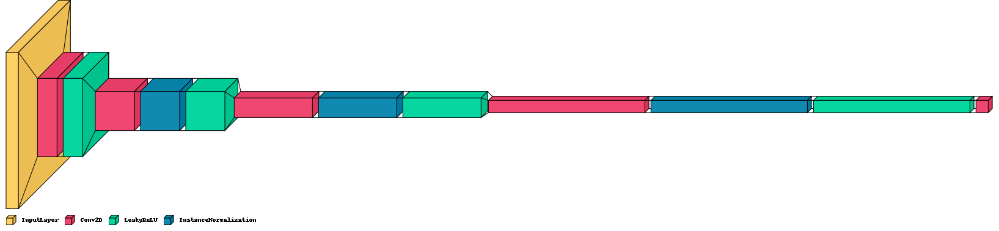

In [13]:
discriminator_cg = discriminator()
visualkeras.layered_view(discriminator_cg, scale_xy = 1, scale_z=0.5, legend=True)

## Generator

Define the Generator

In [14]:
# "dk denotes a 3×3 Convolution-InstanceNorm-ReLU with k filters and stride 2"
def dk(k, use_instancenorm=True):
    block = Sequential()
    block.add(Conv2D(k, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer))
    if use_instancenorm:
        block.add(InstanceNormalization(axis=-1))
    block.add(Activation('relu'))

    return block

# "uk denotes a 3×3 fractional-strided-ConvolutionInstanceNorm-ReLU layer with k filters and stride ½"
def uk(k):
    block = Sequential()
    block.add(Conv2DTranspose(k, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer))
    block.add(InstanceNormalization(axis=-1))
    block.add(Activation('relu'))

    return block

def generator():
    gen_input = Input(shape=(img_rows, img_cols, channels))
    
    # Layers for the encoder part of the model
    encoder_layers = [
        dk(64, False),
        dk(128),
        dk(256),
        dk(512),
        dk(512),
        dk(512),
        dk(512),
        dk(512)
    ]

    # Layers for the decoder part of the model
    decoder_layers = [
        uk(512),
        uk(512),
        uk(512),
        uk(512),
        uk(256),
        uk(128),
        uk(64)
    ]

    gen = gen_input

    # Add all the encoder layers, and keep track of them for skip connections
    skips = []
    for layer in encoder_layers:
        gen = layer(gen)
        skips.append(gen)
    
    skips = skips[::-1][1:] # Reverse for looping and get rid of the layer that directly connects to decoder

    # Add all the decoder layers and skip connections
    for skip_layer, layer in zip(skips, decoder_layers):
        gen = layer(gen)
        gen = Concatenate()([gen, skip_layer])

    
    # Final layer
    gen = Conv2DTranspose(channels, (3, 3), strides=2, padding='same', kernel_initializer=weight_initializer, activation='tanh')(gen)
    
    # Compose model
    return Model(gen_input, gen)

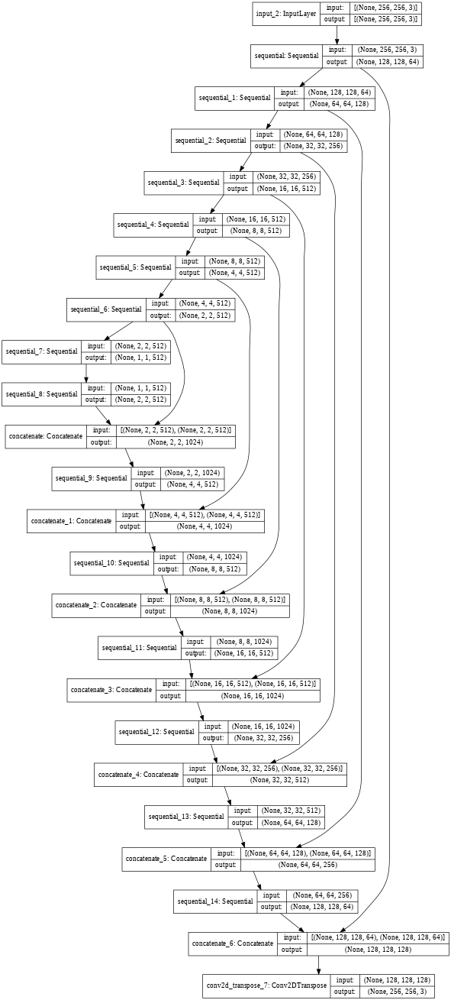

In [15]:
generator_cg = generator()
tf.keras.utils.plot_model(generator_cg, show_shapes=True, dpi=48)

Instantiate the generators and discriminators of the CycleGAN

In [16]:
generator_g = generator() # generates anime images from real-life input images
generator_f = generator() # generates real-life images from anime input images


discriminator_x = discriminator() # takes in real-life and generated real-life images and 
                                  # output probability it is real-life
discriminator_y = discriminator() # takes in anime and generated anime images and 
                                  # output probability it is anime

## Loss Function

Define the loss functions

In [17]:
loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Measures how close to one real images are rated, and how close to zero fake images are rated
def discriminator_loss(real, generated):
    # Multiplied by 0.5 so that it will train at half-speed
    return (loss(tf.ones_like(real), real) + loss(tf.zeros_like(generated), generated)) * 0.5

# Measures how real the discriminator believes the fake image is
def gen_loss(validity):
    return loss(tf.ones_like(validity), validity)

# Measures similarity of two images.  Used for cycle and identity loss
def image_similarity(image1, image2):
    return tf.reduce_mean(tf.abs(image1 - image2))

Define a function for generating and saving a random anime images at each epoch

In [18]:
def generate_images():
    # Sample images
    real = next(iter(real_ds_train.shuffle(1000))).numpy()
    
    # Get predictions for those images. We are only interested in generated anime images from real-life inputs
    anime_hat = generator_g.predict(real.reshape((1, img_rows, img_cols, channels)))
    
    plt.figure(figsize=(15, 7.5))

    images = [real[0], anime_hat[0]]
    title = ['Input Image', 'Predicted Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow(images[i] * 0.5 + 0.5)
        plt.axis('off')
    # plt.tight_layout()

    output_path = os.path.join(data_path,'generated_images')
    if not os.path.exists(output_path):
      os.makedirs(output_path)

    filename = os.path.join(output_path,f"train-{epoch}.png")
    plt.savefig(filename)
    plt.show()

Construct a Checkpoint object

In [19]:
checkpoint_path = data_path +'training_checkpoints'

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           gen_g_optimizer=gen_g_optimizer,
                           gen_f_optimizer=gen_f_optimizer,
                           dis_x_optimizer=dis_x_optimizer,
                           dis_y_optimizer=dis_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


Train the model with LAMBDA = 20.

In [20]:
@tf.function
def step(real_x, real_y):  #real_x : anime, real_y : real-life 
    with tf.GradientTape(persistent=True) as tape:
        # setup Dy loss - how well Discriminator y classify true and generated anime images
        fake_y = generator_g(real_x, training=True) # fake_y : fake anime
        gen_g_validity = discriminator_y(fake_y, training=True)
        dis_y_loss = discriminator_loss(discriminator_y(real_y, training=True), gen_g_validity)

        with tape.stop_recording():
            discriminator_y_gradients = tape.gradient(dis_y_loss, discriminator_y.trainable_variables)
            dis_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

        # setup Dx loss - how well Discriminator x classify true and generated real-life images
        fake_x = generator_f(real_y, training=True) # fake_x : fake real-life
        gen_f_validity = discriminator_x(fake_x, training=True)
        dis_x_loss = discriminator_loss(discriminator_x(real_x, training=True), gen_f_validity)

       # calculate gradient and update weights of discriminators
        with tape.stop_recording():
            discriminator_x_gradients = tape.gradient(dis_x_loss, discriminator_x.trainable_variables)
            dis_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))

        # setup adversarial losses
        gen_g_adv_loss = gen_loss(gen_g_validity) # how well generator_g outputs anime which discriminator_y 
                                                  # thinks is real anime
        gen_f_adv_loss = gen_loss(gen_f_validity) # how well generator_f outputs real-life images which
                                                  # discriminator_y thinks is real-life

        # setup cycle losses
        cyc_x = generator_f(fake_y, training=True) 
        cyc_x_loss = image_similarity(real_x, cyc_x) # similarity between real-life image and generated real-life
                                                     # image from one cycle through generator_g followed by generator_f

        cyc_y = generator_g(fake_x, training=True)
        cyc_y_loss =  image_similarity(real_y, cyc_y) # similarity between anime image and generated anime image
                                                      # from one cycle through generator_f followed by generator_g
        
        # Setup identity losses
        id_x = generator_f(real_x, training=True)
        id_x_loss = image_similarity(real_x, id_x) # similarity between real-life image and generated real-life image
                                                   # through inputting real-life image into generator_f

        id_y = generator_g(real_y, training=True)
        id_y_loss = image_similarity(real_y, id_y) # similarity between anime image and generated anime image
                                                   # through inputting anime image into generator_g

        # Finalize generator losses and calc gradients
        # LAMBDA scales cyclic losses importance w.r.t. adversarial losses
        # LAMBDA_IDENT scales identity losses importance further w.r.t. adversarial losses
        gen_g_loss = gen_g_adv_loss + (cyc_x_loss + cyc_y_loss) * LAMBDA + id_y_loss * LAMBDA_IDENT*LAMBDA
        gen_f_loss = gen_f_adv_loss + (cyc_x_loss + cyc_y_loss) * LAMBDA + id_x_loss * LAMBDA_IDENT*LAMBDA

        # calculate gradient and update weights of generators
        with tape.stop_recording():
            generator_g_gradients = tape.gradient(gen_g_loss, generator_g.trainable_variables)
            gen_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))

            generator_f_gradients = tape.gradient(gen_f_loss, generator_f.trainable_variables)
            gen_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))

Once again, the cell was keyboard interrupted at epoch no. 58 before the specified 200 epochs as the quality of the generated anime portraits show no sign of improvement after increasing the LAMBDA parameter to 20.

Epoch: 0
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


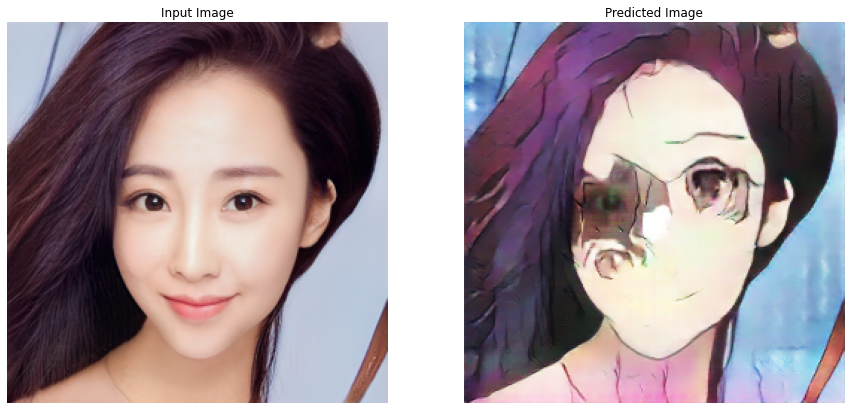

Time taken: 230.05072927474976
Epoch: 1
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


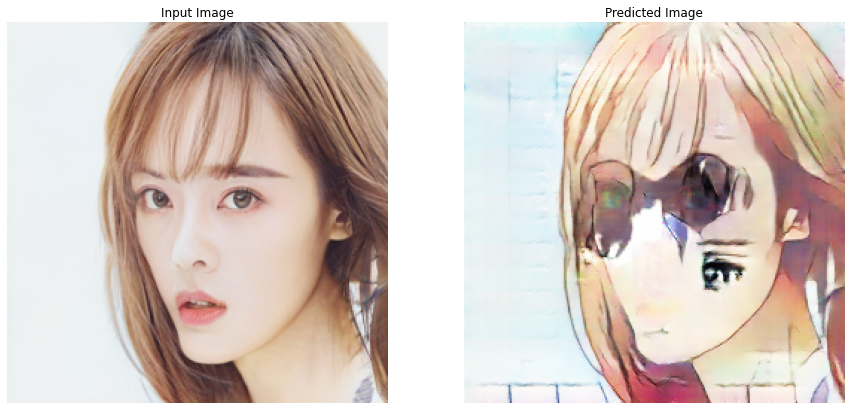

Time taken: 188.34320640563965
Epoch: 2
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


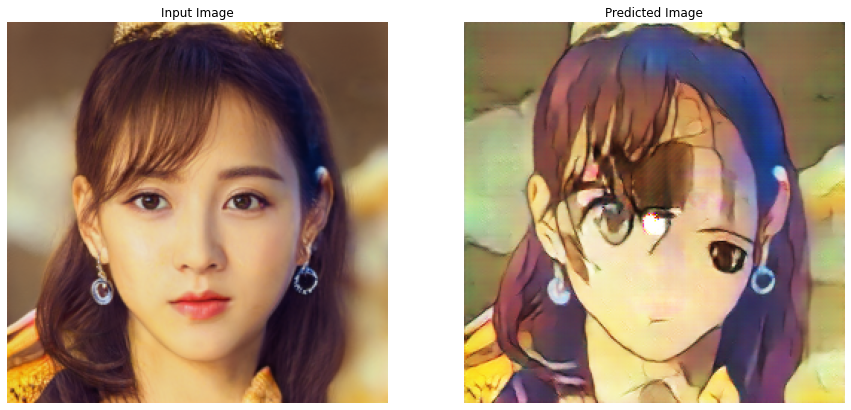

Time taken: 188.48038625717163
Epoch: 3
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


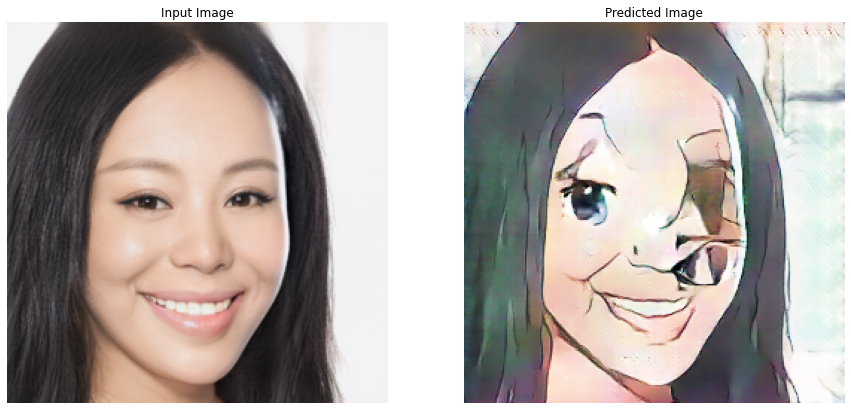

Time taken: 188.39229774475098
Epoch: 4
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


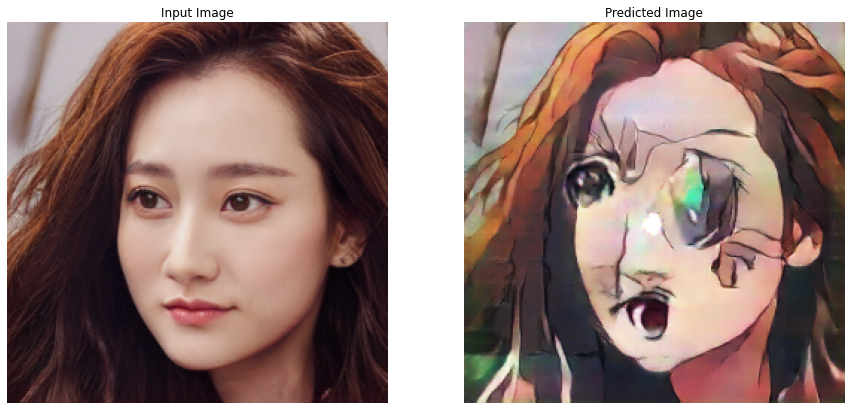

Time taken: 188.49687719345093
Epoch: 5
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


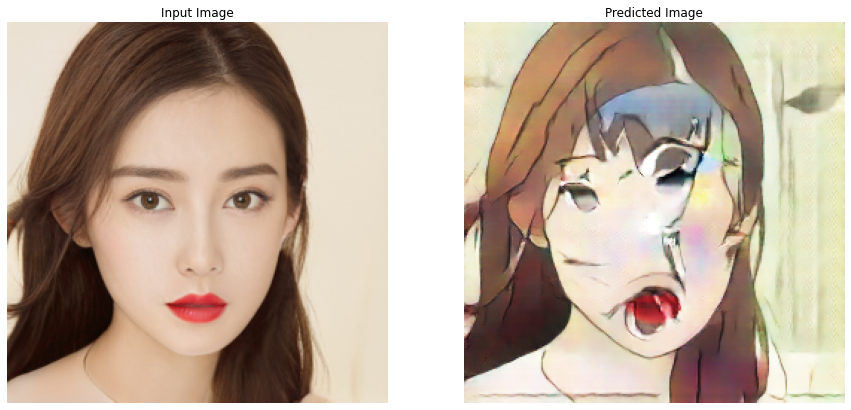

Time taken: 188.414160490036
Epoch: 6
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


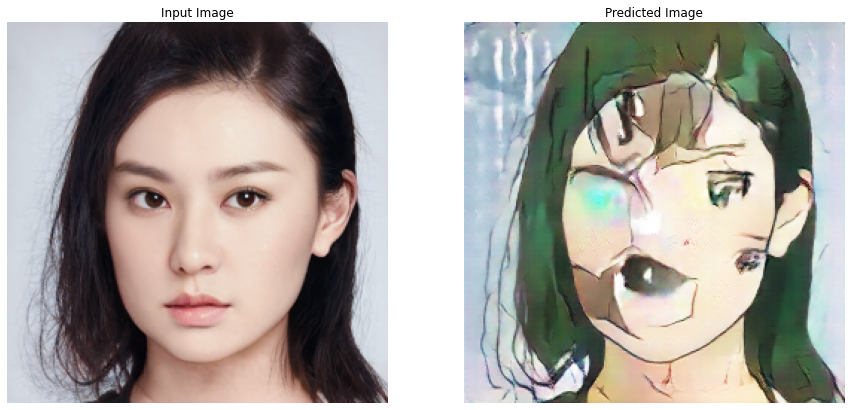

Time taken: 188.985116481781
Epoch: 7
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


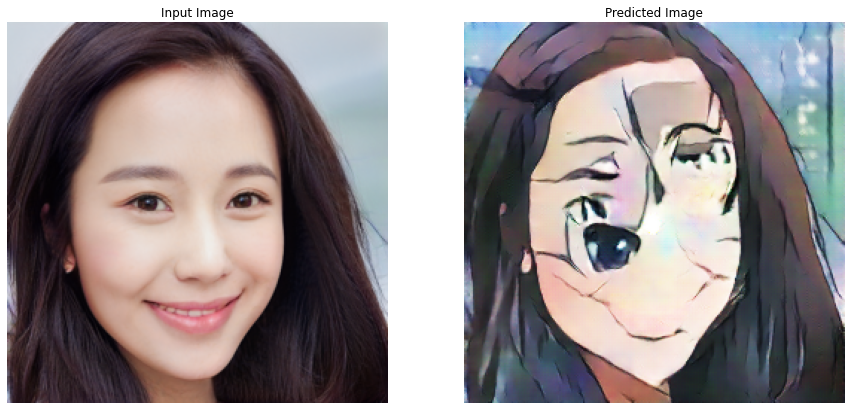

Time taken: 188.36050510406494
Epoch: 8
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


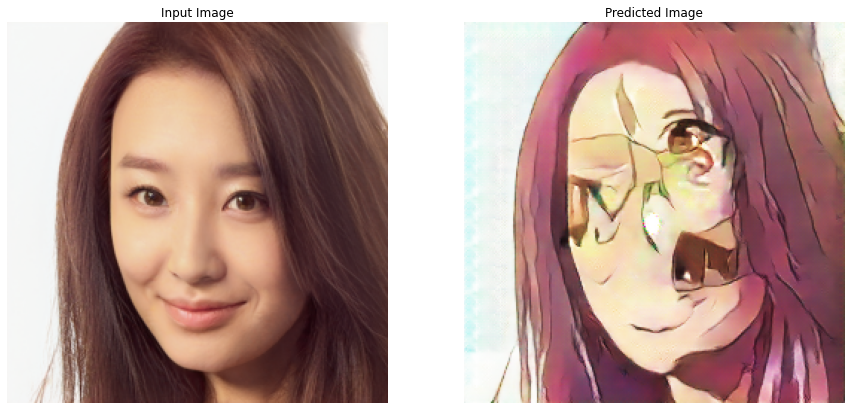

Time taken: 188.34358072280884
Epoch: 9
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


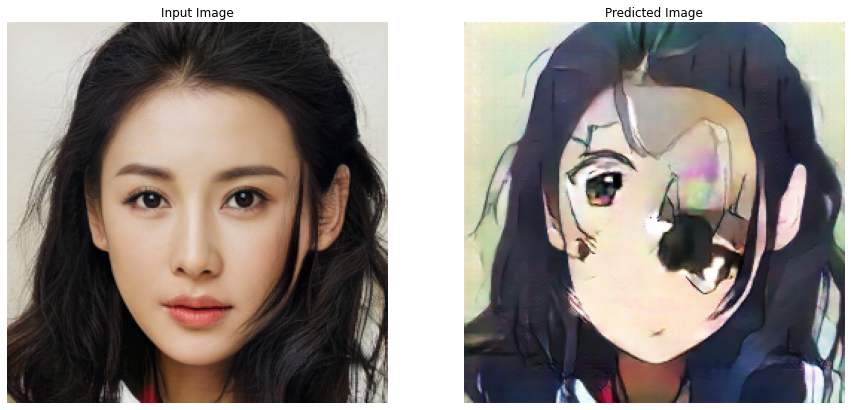

Time taken: 188.49488830566406
Epoch: 10
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


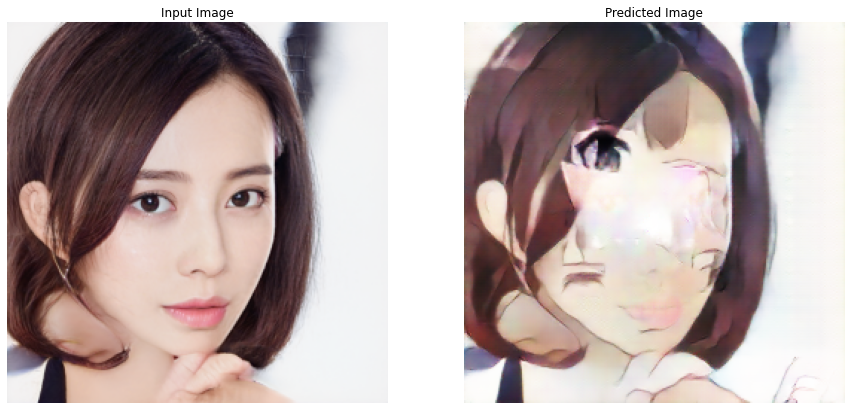

Time taken: 188.67765188217163
Epoch: 11
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


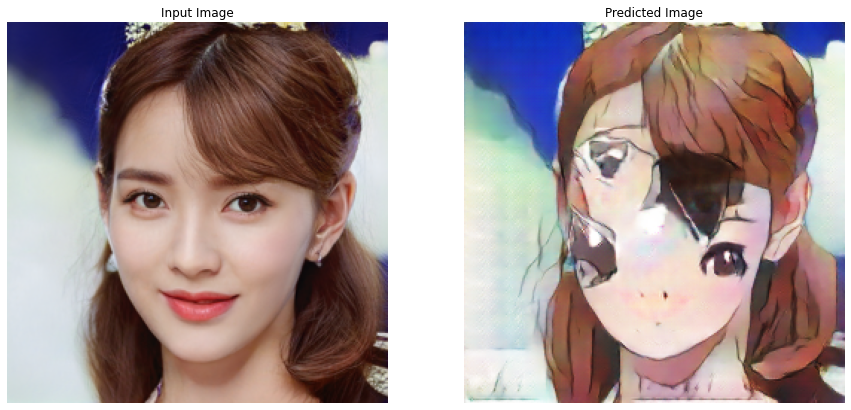

Time taken: 188.42029428482056
Epoch: 12
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


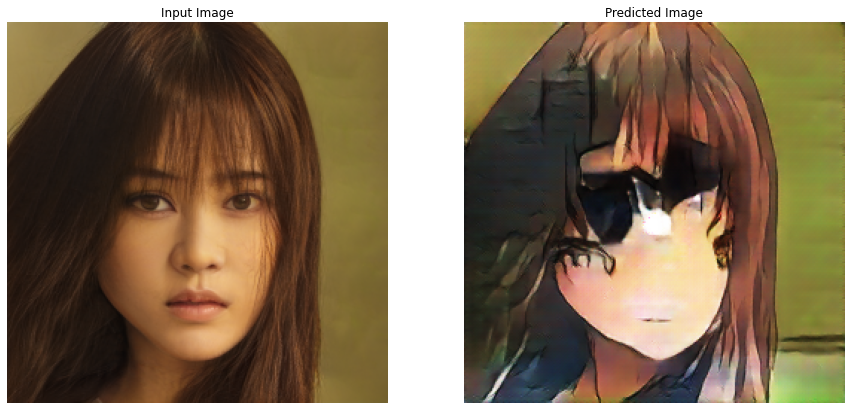

Time taken: 188.3764808177948
Epoch: 13
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


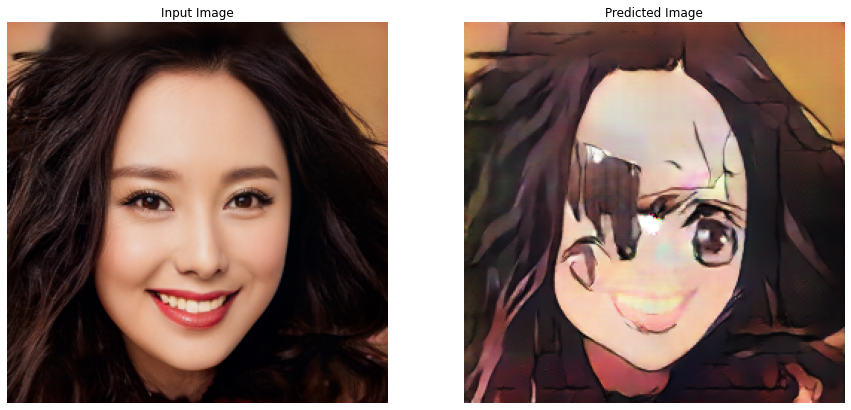

Time taken: 203.3107705116272
Epoch: 14
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


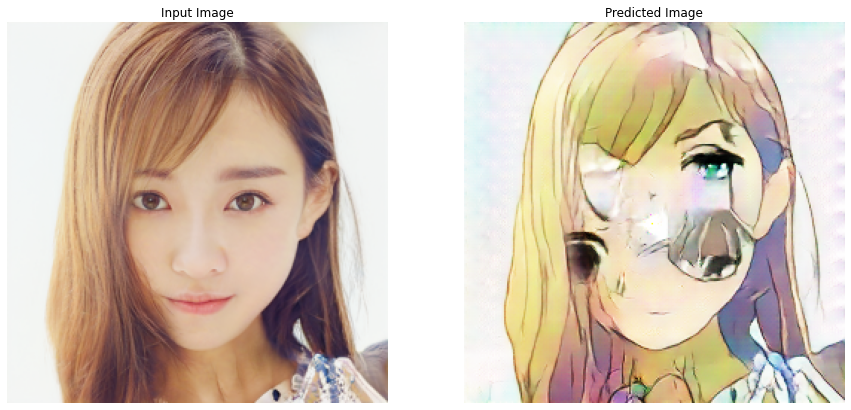

Time taken: 188.43434762954712
Epoch: 15
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


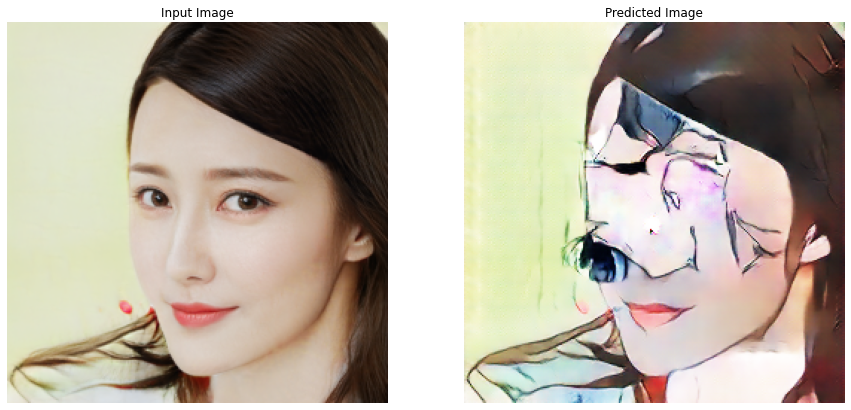

Time taken: 203.30048370361328
Epoch: 16
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


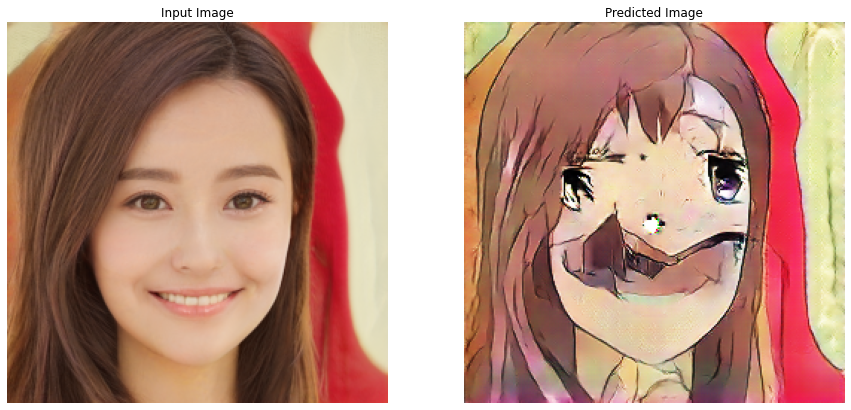

Time taken: 188.63503670692444
Epoch: 17
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


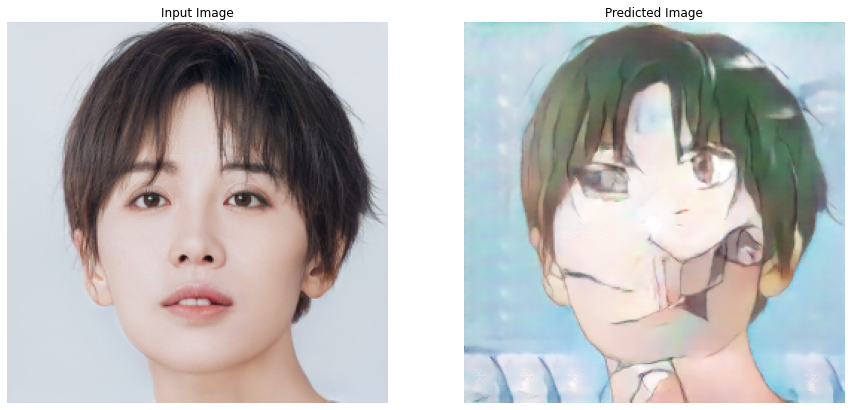

Time taken: 188.53039169311523
Epoch: 18
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


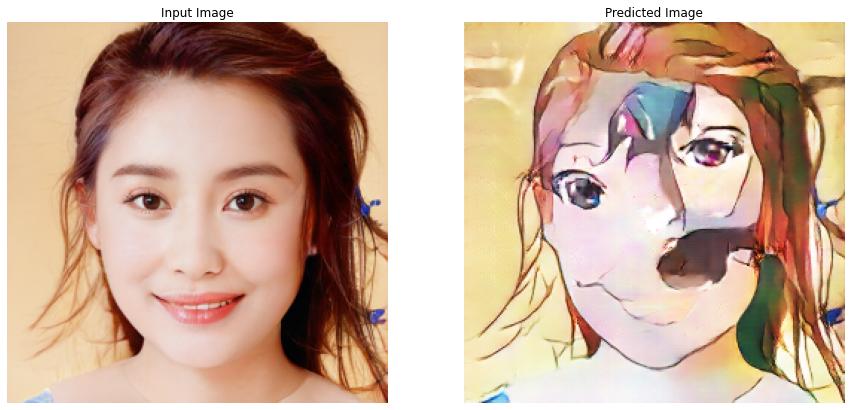

Time taken: 188.5870223045349
Epoch: 19
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


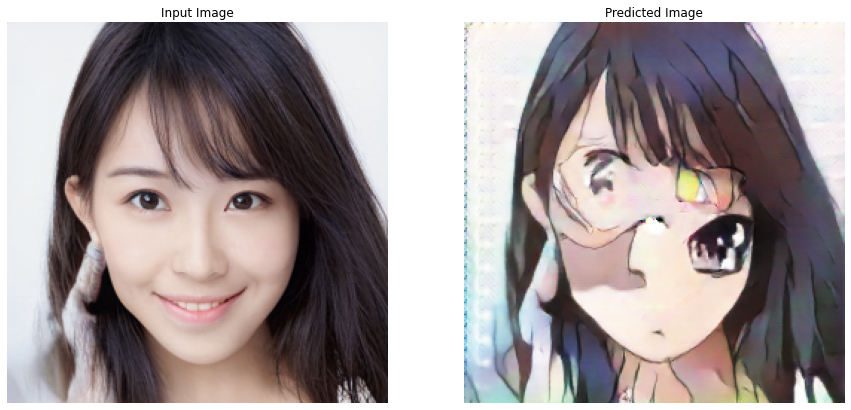

Saving checkpoint for epoch 20 at gdrive/My Drive/Capstone/CycleGANfacev1(l1)/training_checkpoints/ckpt-2
Time taken: 192.40327548980713
Epoch: 20
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


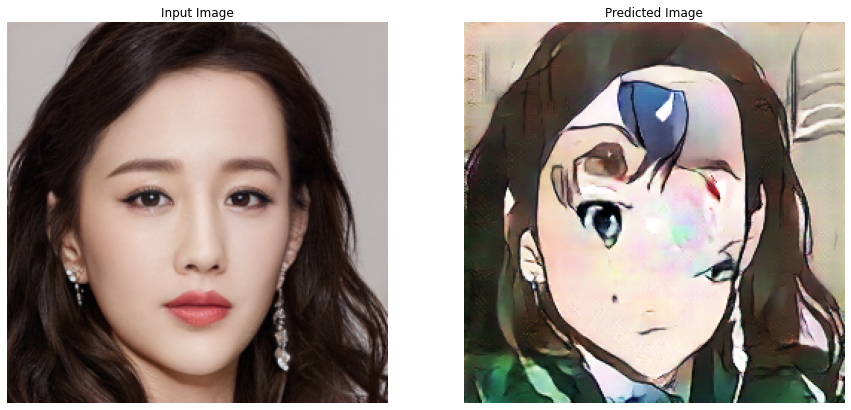

Time taken: 188.92727041244507
Epoch: 21
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


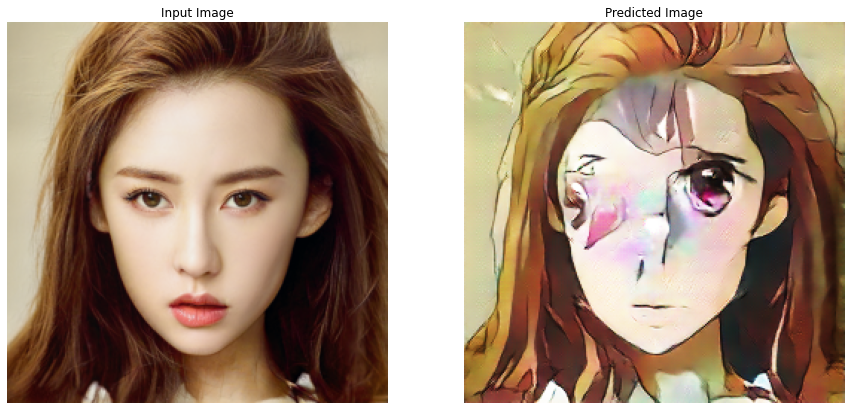

Time taken: 188.51847577095032
Epoch: 22
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


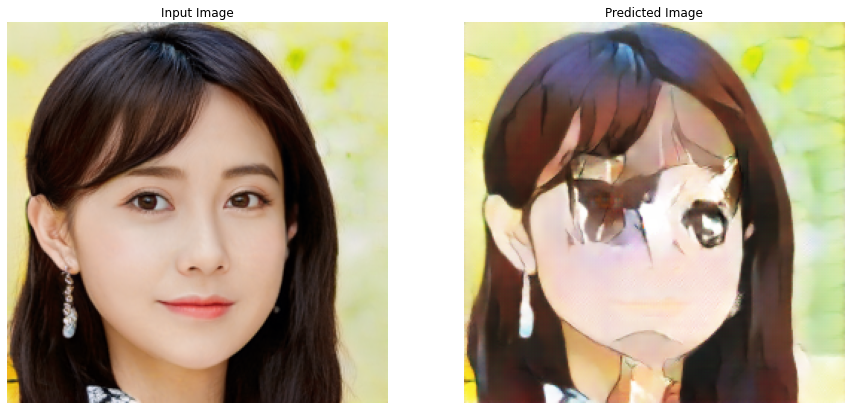

Time taken: 188.34673619270325
Epoch: 23
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


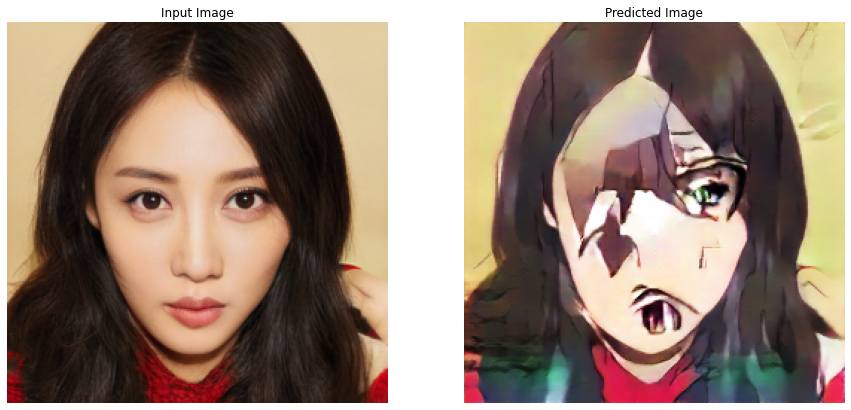

Time taken: 188.43752551078796
Epoch: 24
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


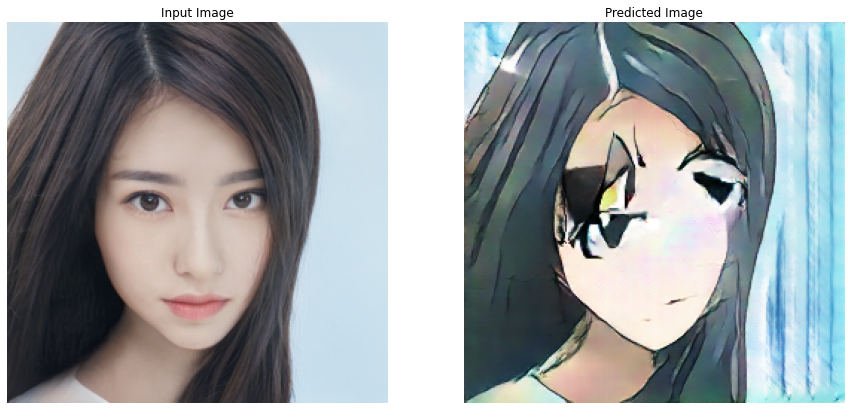

Time taken: 188.49796509742737
Epoch: 25
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


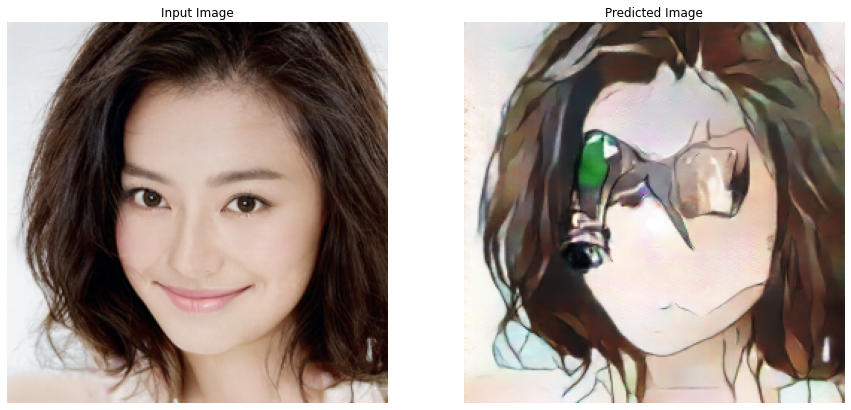

Time taken: 188.46771216392517
Epoch: 26
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


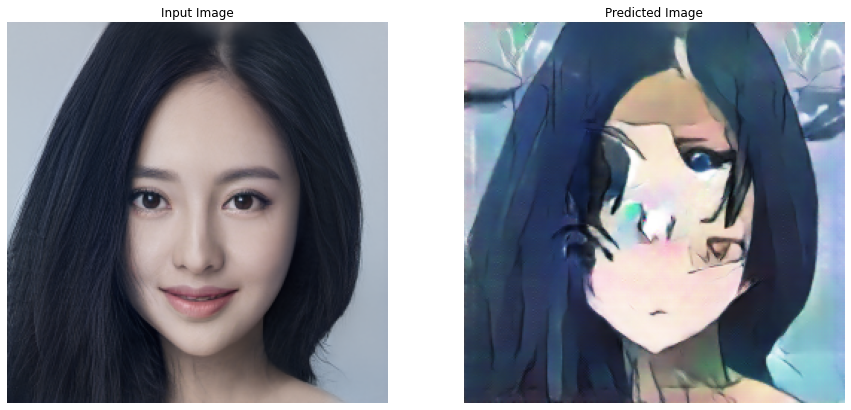

Time taken: 188.50463581085205
Epoch: 27
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


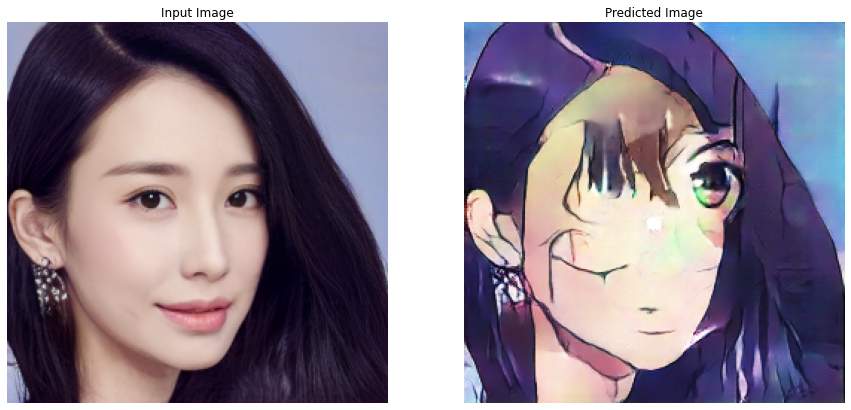

Time taken: 188.45879554748535
Epoch: 28
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


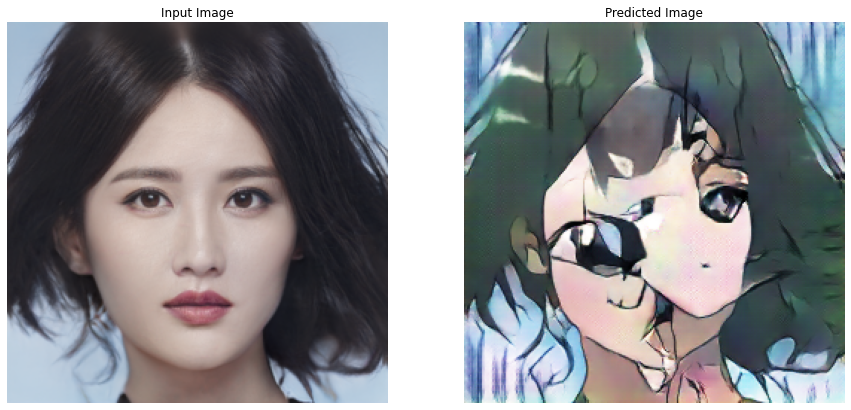

Time taken: 188.43990874290466
Epoch: 29
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


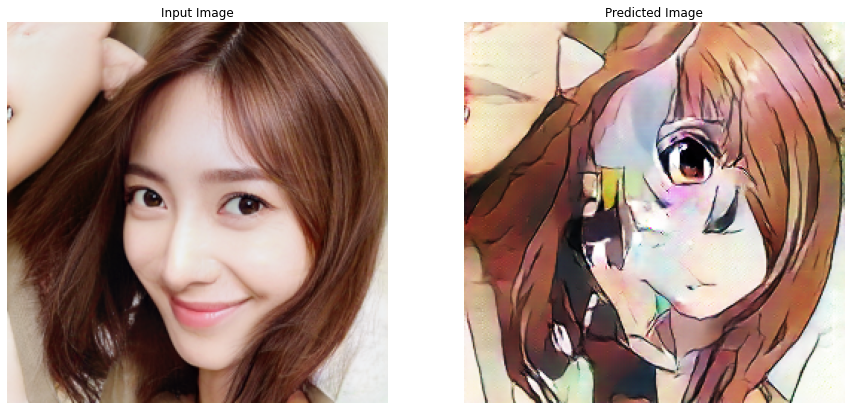

Time taken: 188.49476265907288
Epoch: 30
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


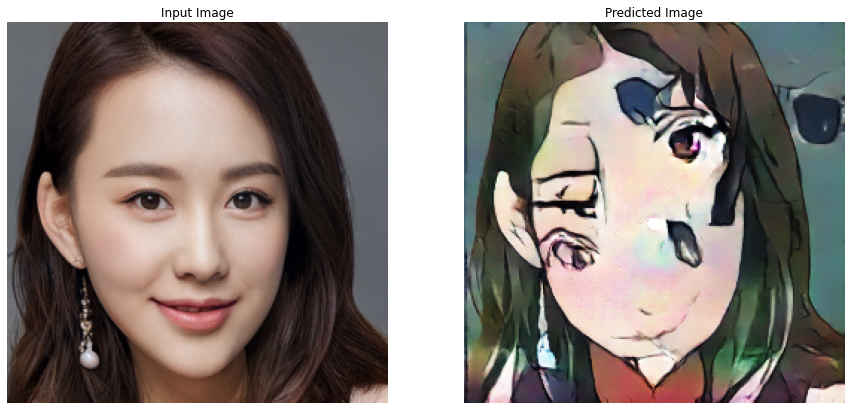

Time taken: 188.5446286201477
Epoch: 31
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


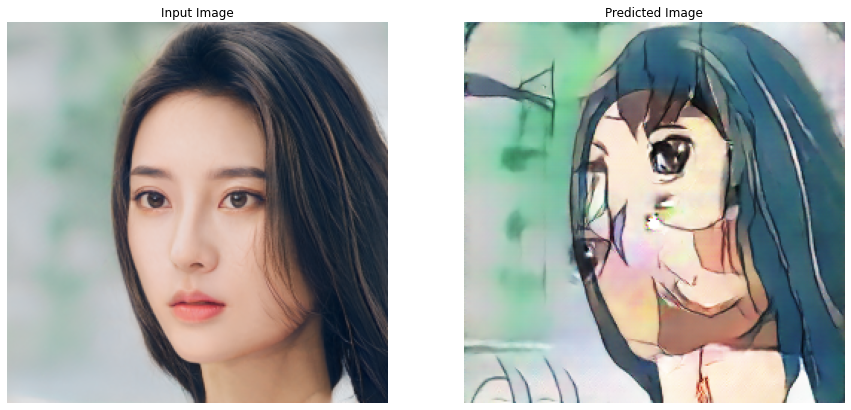

Time taken: 188.5175495147705
Epoch: 32
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


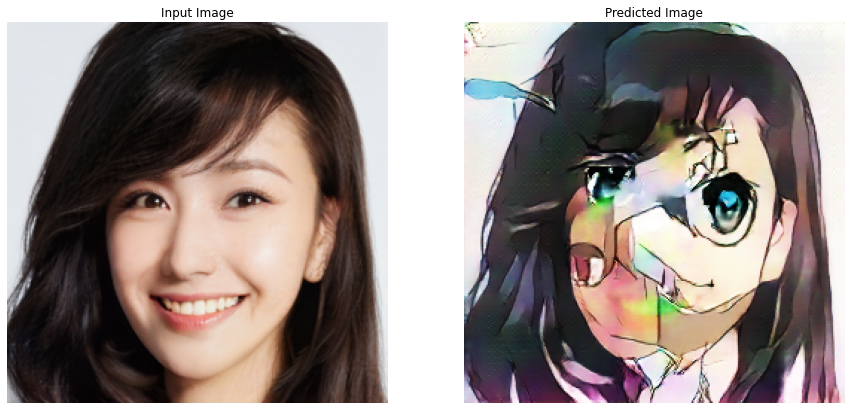

Time taken: 188.4003562927246
Epoch: 33
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


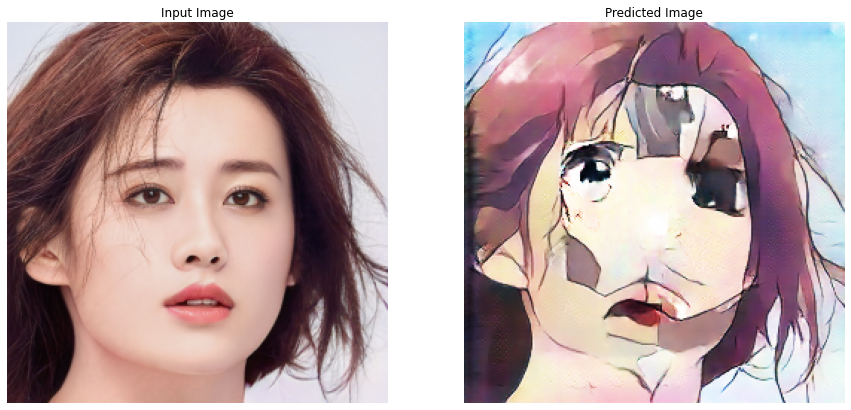

Time taken: 188.4290542602539
Epoch: 34
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


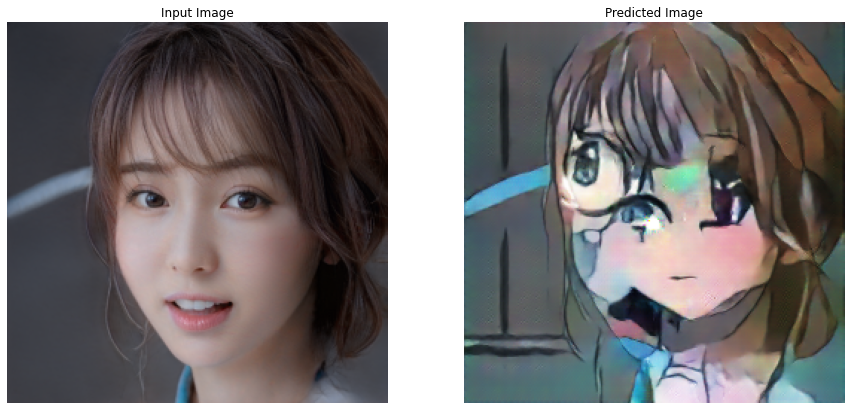

Time taken: 188.57309985160828
Epoch: 35
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


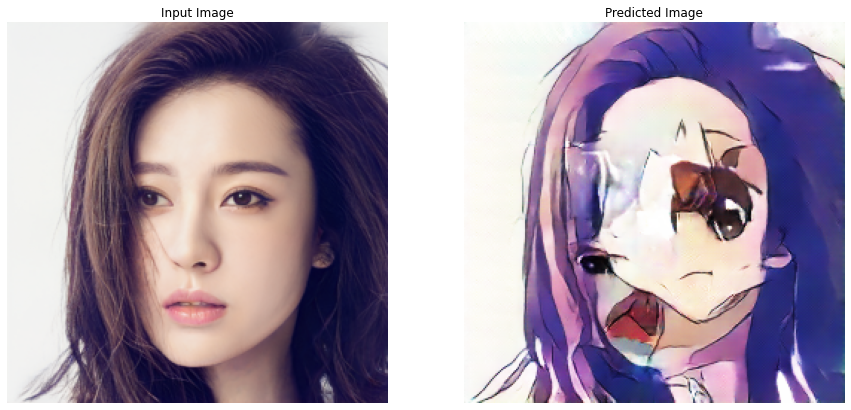

Time taken: 188.43901705741882
Epoch: 36
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


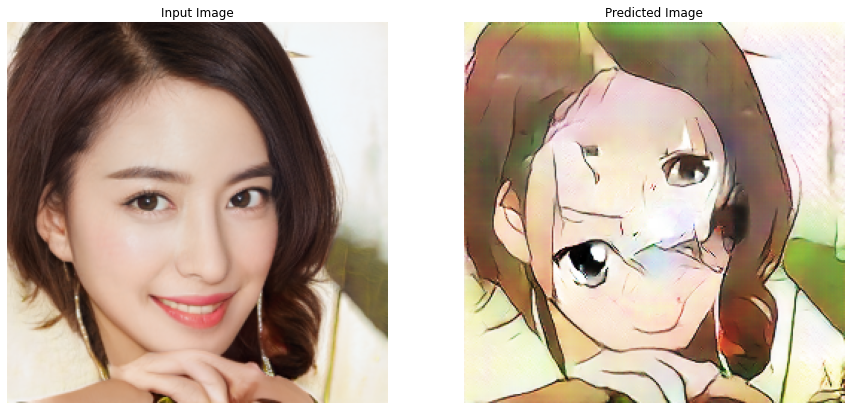

Time taken: 188.58136653900146
Epoch: 37
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


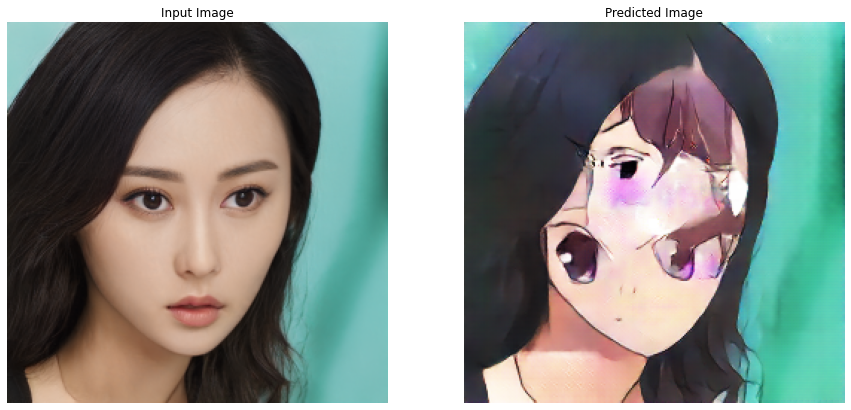

Time taken: 188.50262713432312
Epoch: 38
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


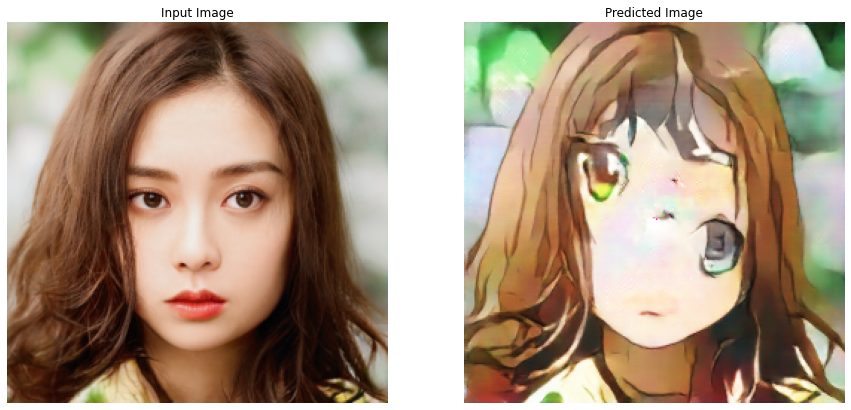

Time taken: 188.62413787841797
Epoch: 39
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


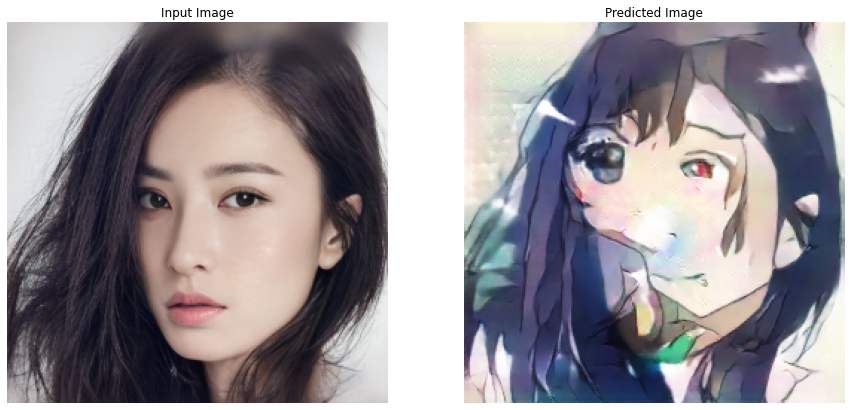

Saving checkpoint for epoch 40 at gdrive/My Drive/Capstone/CycleGANfacev1(l1)/training_checkpoints/ckpt-3
Time taken: 192.4633288383484
Epoch: 40
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


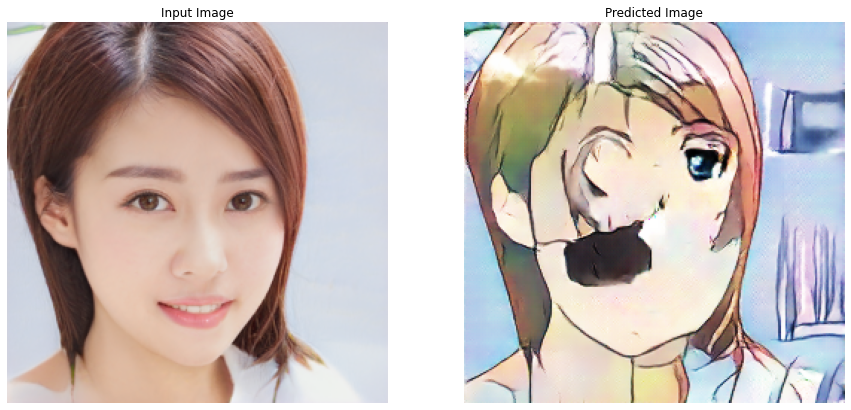

Time taken: 188.593932390213
Epoch: 41
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


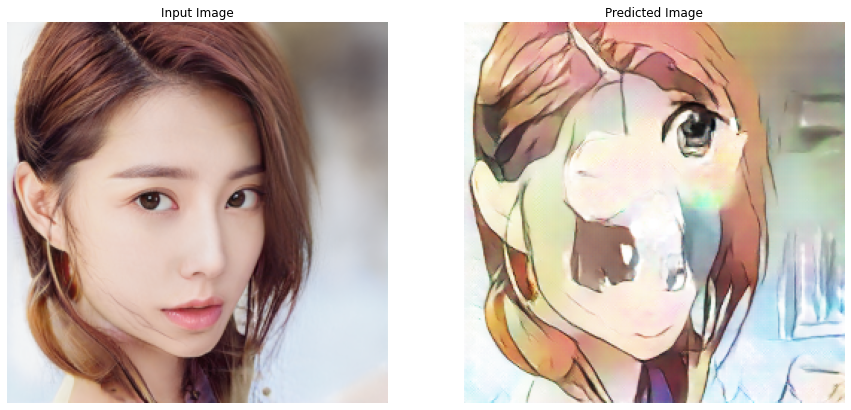

Time taken: 188.65499210357666
Epoch: 42
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


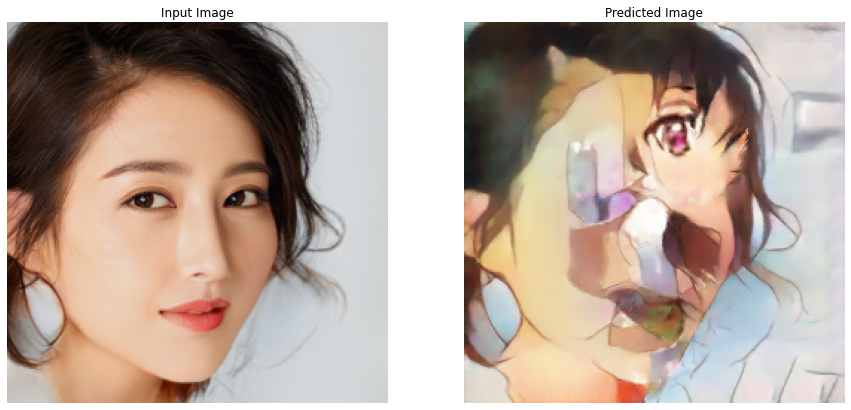

Time taken: 188.559876203537
Epoch: 43
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


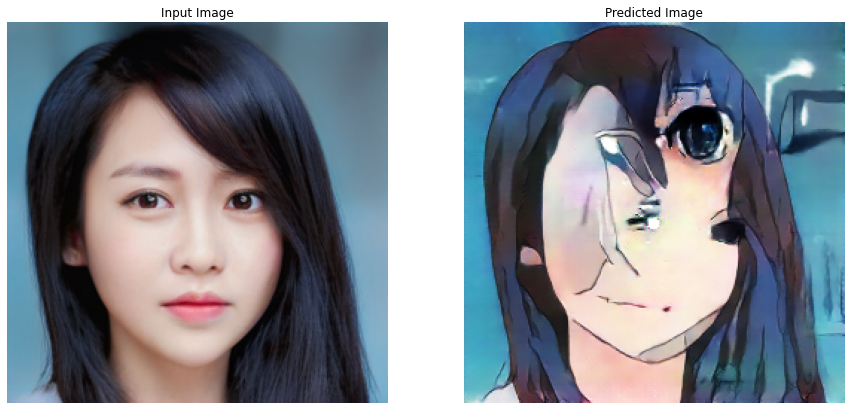

Time taken: 188.42028641700745
Epoch: 44
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


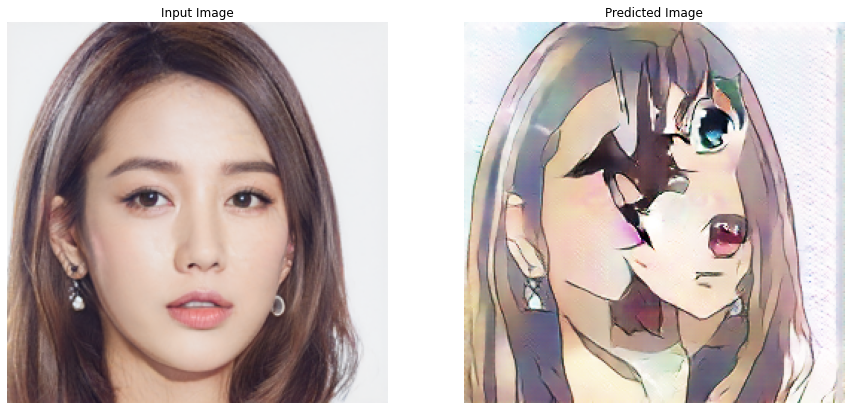

Time taken: 188.57630610466003
Epoch: 45
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


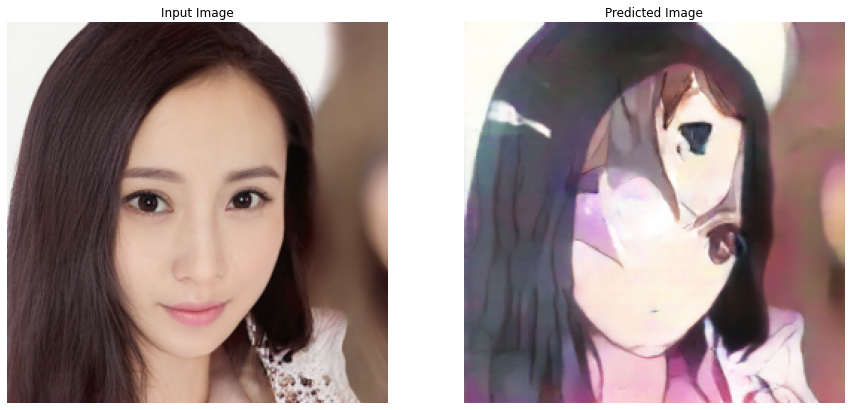

Time taken: 188.43655848503113
Epoch: 46
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


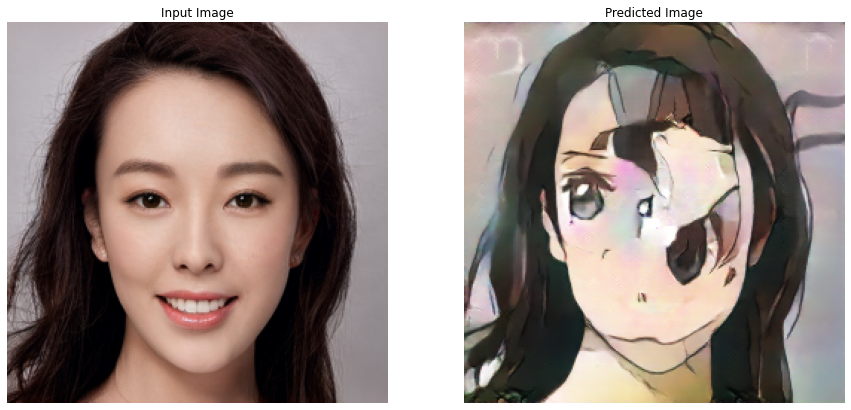

Time taken: 188.32376551628113
Epoch: 47
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


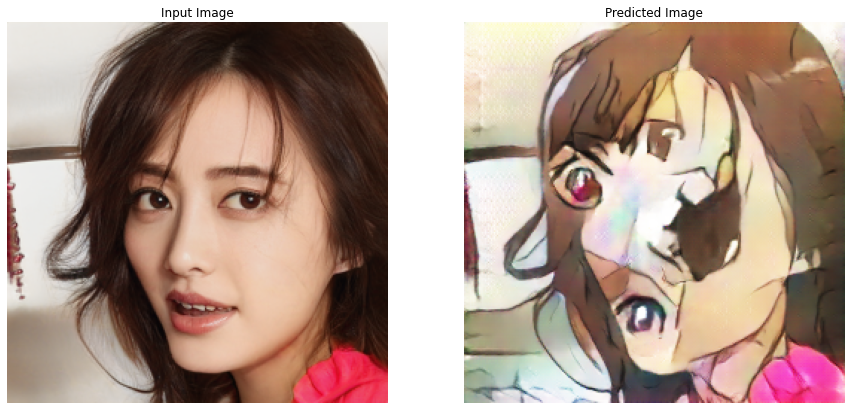

Time taken: 188.91946458816528
Epoch: 48
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


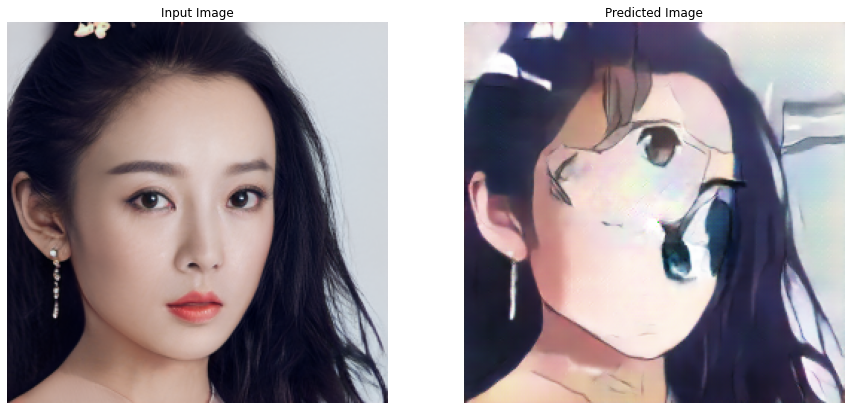

Time taken: 188.2719566822052
Epoch: 49
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


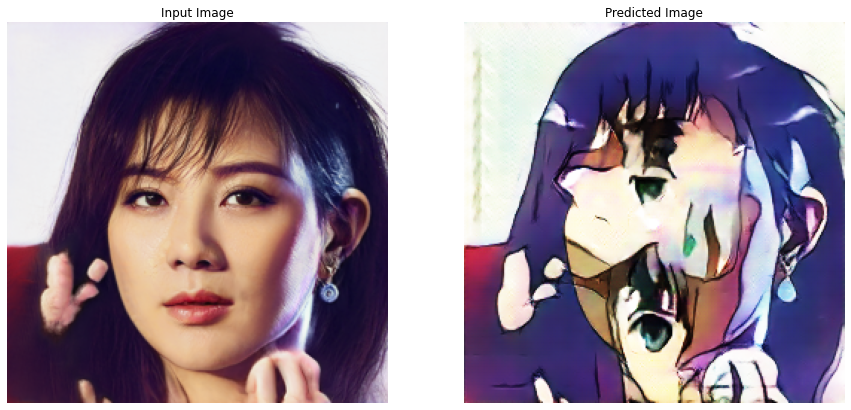

Time taken: 188.39472126960754
Epoch: 50
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


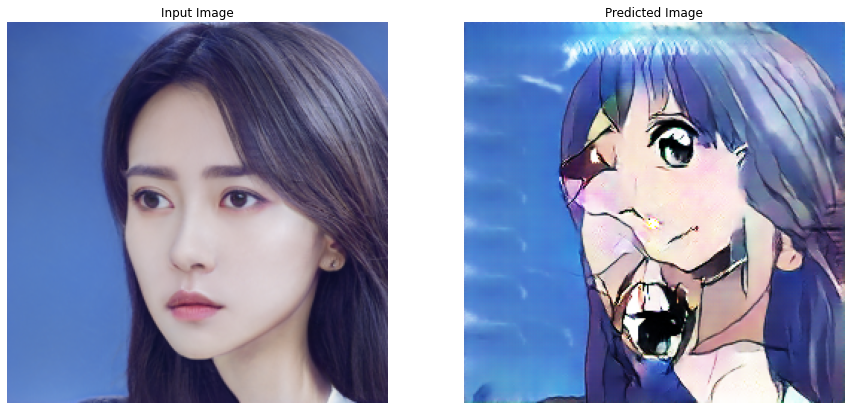

Time taken: 188.4159049987793
Epoch: 51
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


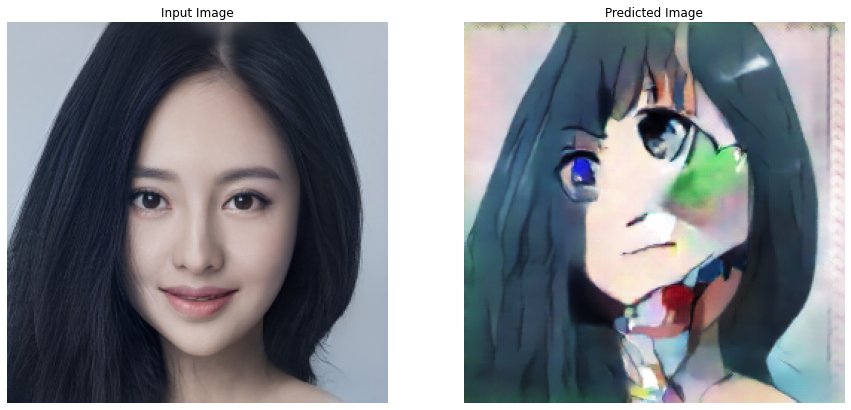

Time taken: 188.48505330085754
Epoch: 52
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


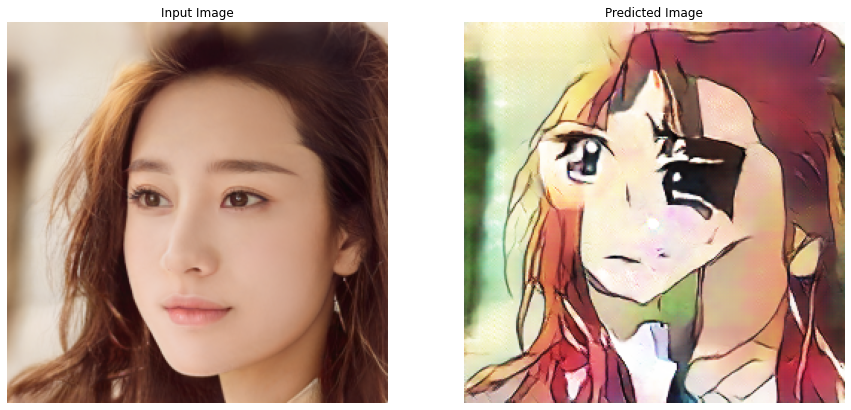

Time taken: 188.3897008895874
Epoch: 53
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


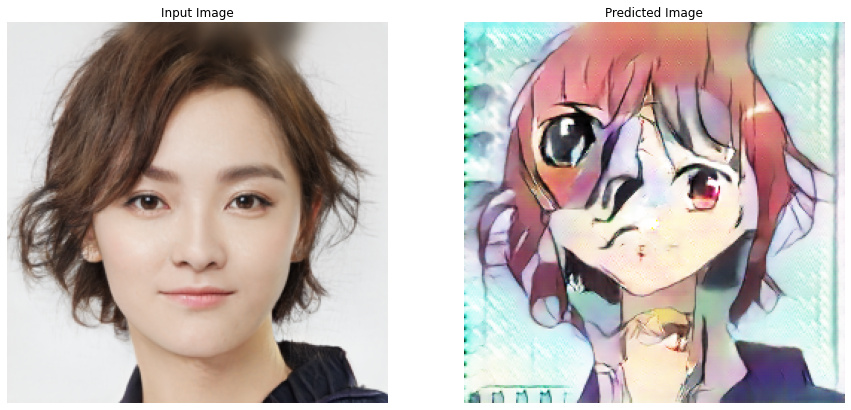

Time taken: 188.42926836013794
Epoch: 54
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


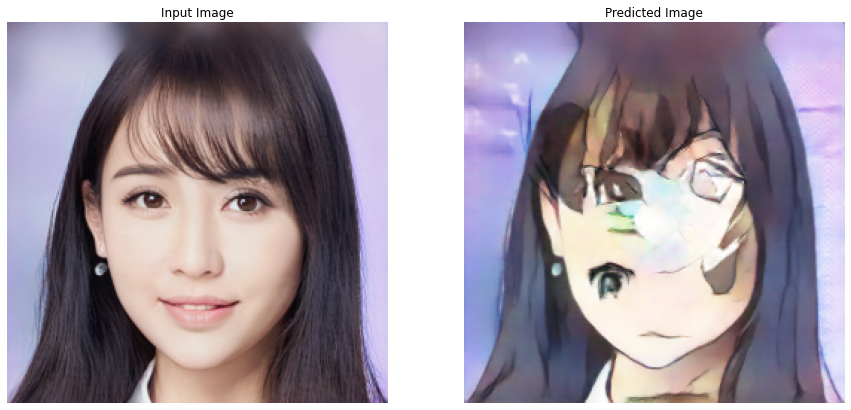

Time taken: 188.32243418693542
Epoch: 55
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


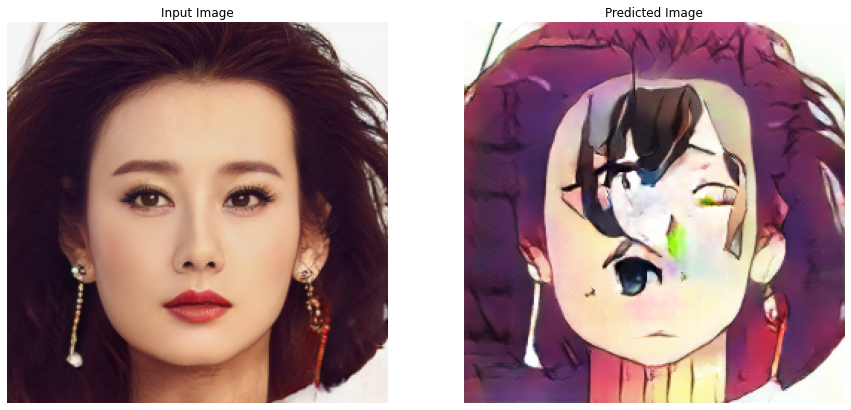

Time taken: 188.30867528915405
Epoch: 56
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


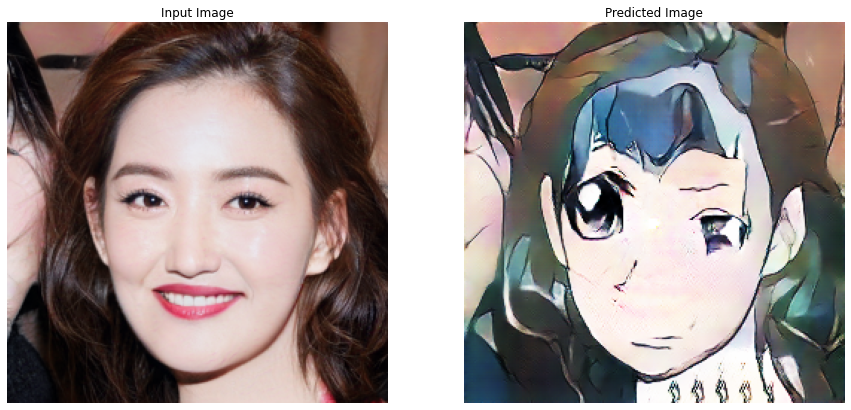

Time taken: 188.35357880592346
Epoch: 57
0
100
200
300
400
500
600
700
800
900
1000
1100
1200


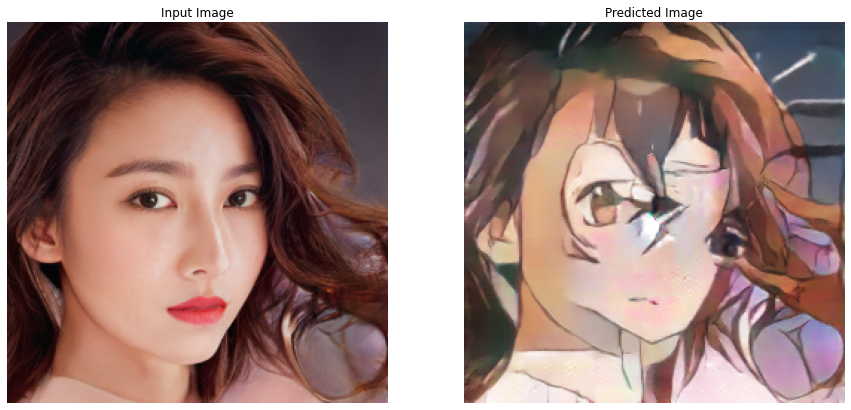

Time taken: 188.38241720199585
Epoch: 58
0
100
200


KeyboardInterrupt: ignored

In [ ]:
# Manually loop through epochs
for epoch in range(epochs):
    print('Epoch: {}'.format(epoch))
    start = time.time()

    # Each batch
    for k, (real_x, real_y) in enumerate(tf.data.Dataset.zip((real_ds_train, anime_ds_train))):
        if k % 100 == 0: print(k)
        # Train step
        step(tf.reshape(real_x, (1, img_rows, img_cols, channels)), tf.reshape(real_y, (1, img_rows, img_cols, channels)))
    
    # View progress
    generate_images()

    # Save the model every 10 epochs
    if (epoch + 1) % 20 == 0:
      ckpt_save_path = ckpt_manager.save()
      print ('Saving checkpoint for epoch {} at {}'.format(epoch+1, 
                                                           ckpt_save_path))
    print('Time taken: {}'.format(time.time() - start))

## Generate Anime from Test Images

Generate Anime Samples from Test Real-Life Images

In [21]:
real_test_paths = ['../data/real_female_portraits_11/v3_0081950.jpg',
                   '../data/real_female_portraits_11/v3_0106693.jpg',
                   '../data/real_female_portraits_11/v3_0342258.jpg',
                   '../data/real_female_portraits_11/v3_0458352.jpg',
                   '../data/real_female_portraits_11/v3_0486690.jpg',
                   '../data/real_female_portraits_11/v3_0489297.jpg',
                   '../data/real_female_portraits_11/v3_0666509.jpg',
                   '../data/real_female_portraits_11/v3_0684698.jpg',
                   '../data/real_female_portraits_11/v3_0749738.jpg',
                   '../data/real_female_portraits_11/v3_0784113.jpg',
                   '../data/real_female_portraits_11/v3_0930467.jpg']

def gen_test_image(test_image_path):
  real_test_image = tf.keras.preprocessing.image.load_img(test_image_path)
  input_arr_test = tf.keras.preprocessing.image.img_to_array(real_test_image)
  input_arr_test = np.array([input_arr_test])
  input_arr_test = preprocess_train_image(input_arr_test)
  input_arr_test = input_arr_test.numpy()
  plt.figure(figsize=(10, 5))
  predictions = generator_g.predict(input_arr_test.reshape((1, img_rows, img_cols, channels)))
  images = [input_arr_test[0], predictions[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
      plt.subplot(1, 2, i+1)
      plt.title(title[i])
      plt.imshow(images[i] * 0.5 + 0.5)
      plt.axis('off')
  # plt.tight_layout()
  plt.show()

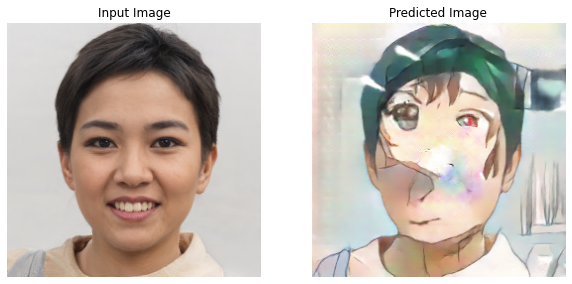

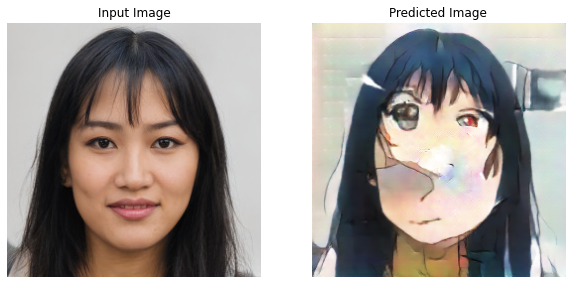

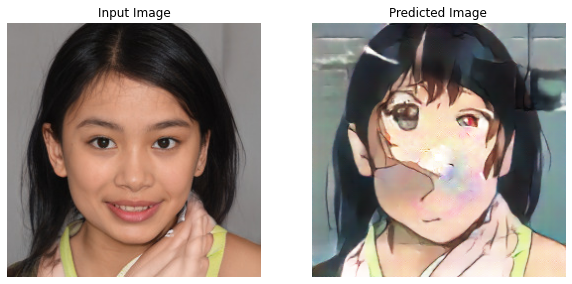

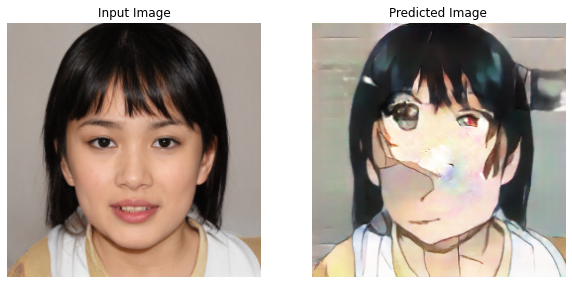

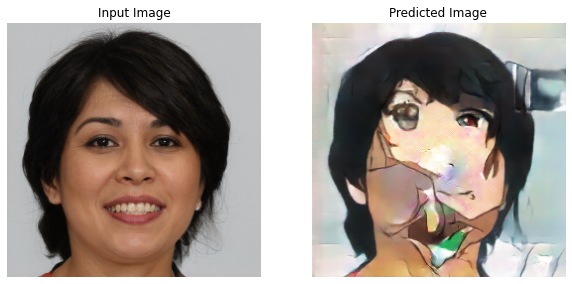

...

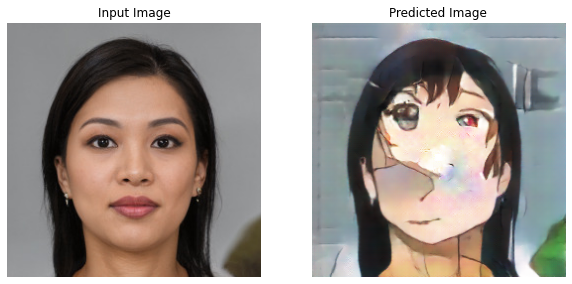

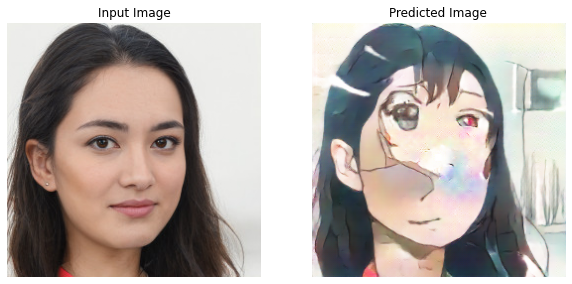

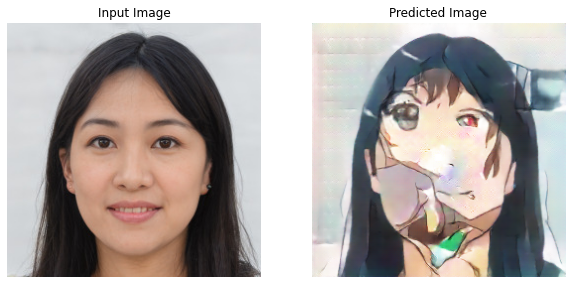

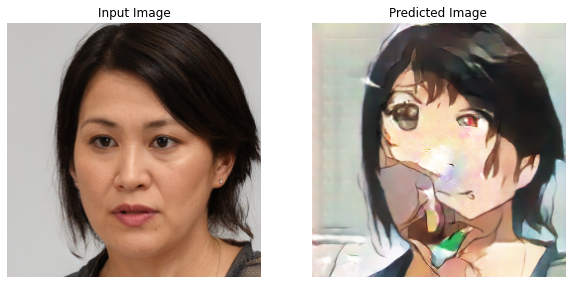

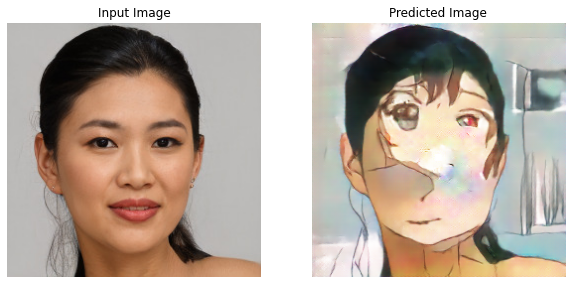

In [22]:
for test_image_path in real_test_paths:
  gen_test_image(test_image_path)

## Key Observations

Once again, the model had problem with facial features right from the start. The problem with image translation may have its origin in the architecture of the generator and discriminator instead of the optimization of LAMBDA. We will attempt to adjust the architecture of the model in the next notebook "CycleGAN Female Portrait ResNet"